In [6]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
from tqdm import tqdm
import torchvision.datasets as datasets
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid
import torchvision.utils as vutils
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torch.utils.data import Subset
import numpy as np


In [7]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
LEARNING_RATE = 2e-4  # could also use two lrs, one for gen and one for disc
BATCH_SIZE = 128
IMAGE_SIZE = 64
CHANNELS_IMG = 3
Z_DIM = 100
NUM_EPOCHS = 5
FEATURES_DISC = 64
FEATURES_GEN = 64

In [8]:
transform = transforms.Compose([
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

dataset = datasets.ImageFolder('data/', transform=transform)
dataloader = DataLoader(dataset=dataset, batch_size=BATCH_SIZE, shuffle=True)

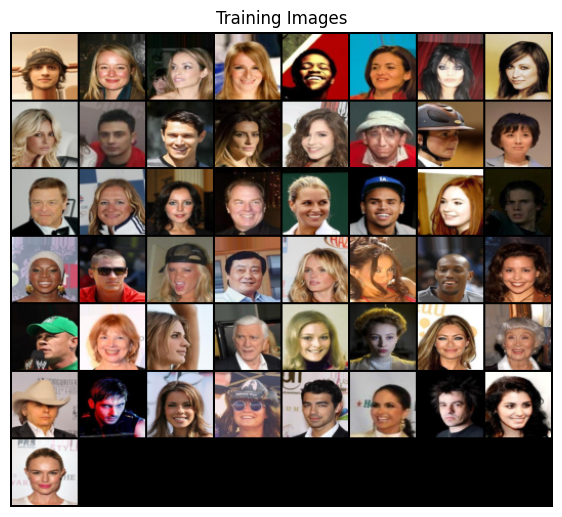

In [9]:
def show_tensor_images(image_tensor, num_images=32, size=(1, 64, 64)):
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=4)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()
    
real_batch = next(iter(dataloader))
plt.figure(figsize=(7,7))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:49], padding=2, normalize=True).cpu(),(1,2,0)))

In [10]:
class Generator(nn.Module):
    def __init__(self, z_dim, channels_img, features_g):
        super(Generator, self).__init__()
        self.net = nn.Sequential(
            self._block(z_dim, features_g * 16, 4, 1, 0),
            self._block(features_g * 16, features_g * 8, 4, 2, 1),
            self._block(features_g * 8, features_g * 4, 4, 2, 1),
            self._block(features_g * 4, features_g * 2, 4, 2, 1),
            nn.ConvTranspose2d(
                features_g * 2, channels_img, kernel_size=4, stride=2, padding=1
            ),
            nn.Tanh()
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.ConvTranspose2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False
            ),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

    def forward(self, x):
        return self.net(x)

In [11]:
class Discriminator(nn.Module):
    def __init__(self, channels_img, features_d):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            nn.Conv2d(channels_img, features_d, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            self._block(features_d, features_d * 2, 4, 2, 1),
            self._block(features_d * 2, features_d * 4, 4, 2, 1),
            self._block(features_d * 4, features_d * 8, 4, 2, 1),
            nn.Conv2d(features_d * 8, 1, kernel_size=4, stride=2, padding=0),
            nn.Sigmoid()
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.Conv2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False
            ),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(0.2)
        )

    def forward(self, x):
        return self.disc(x)

In [12]:
def initialize_weights(model):
    classname = model.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(model.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(model.weight.data, 1.0, 0.02)
        nn.init.constant_(model.bias.data, 0)

gen = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN).to(device)
disc = Discriminator(CHANNELS_IMG, FEATURES_DISC).to(device)

initialize_weights(gen)
initialize_weights(disc)

In [13]:
opt_gen = optim.Adam(gen.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))
opt_disc = optim.Adam(disc.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))
criterion = nn.BCELoss()

fixed_noise = torch.randn(32, Z_DIM, 1, 1).to(device)


Epoch [0/5] Batch 0/1583                   Loss D: 0.7468, loss G: 2.9576


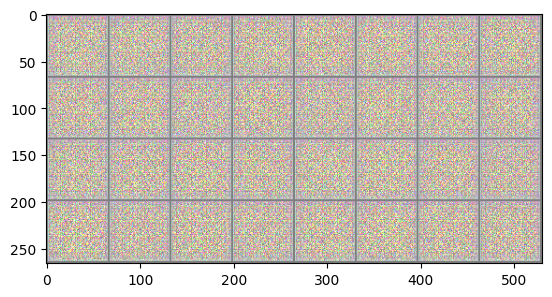

Epoch [0/5] Batch 50/1583                   Loss D: 0.5760, loss G: 9.3629


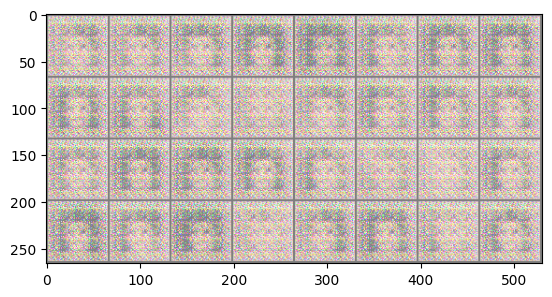

Epoch [0/5] Batch 100/1583                   Loss D: 0.6386, loss G: 1.5155


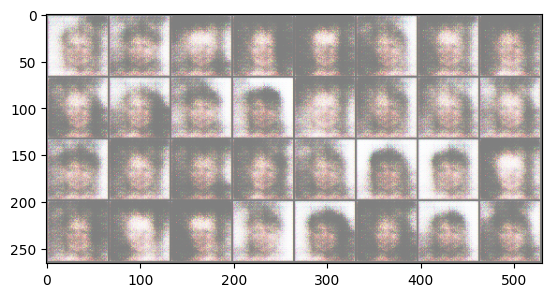

Epoch [0/5] Batch 150/1583                   Loss D: 0.7076, loss G: 0.6857


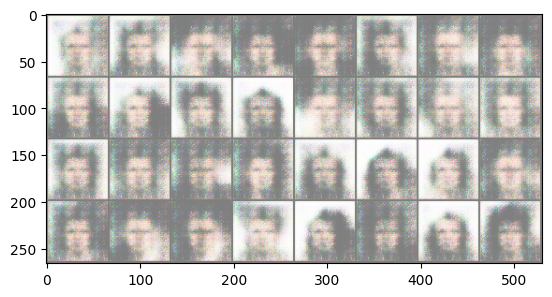

Epoch [0/5] Batch 200/1583                   Loss D: 0.6513, loss G: 2.1806


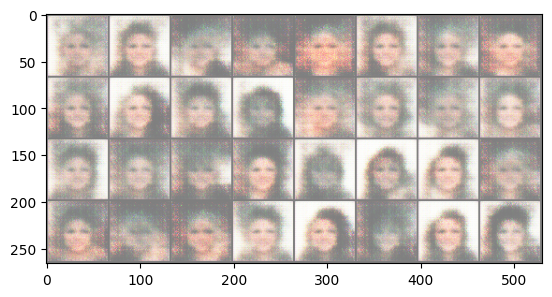

Epoch [0/5] Batch 250/1583                   Loss D: 0.5644, loss G: 0.7521


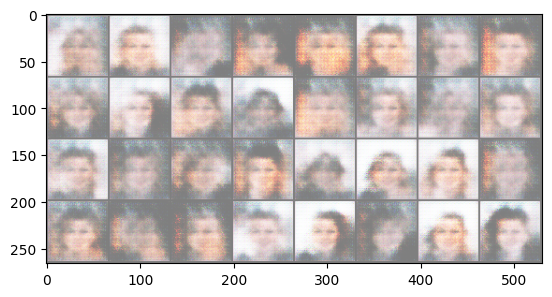

Epoch [0/5] Batch 300/1583                   Loss D: 0.6003, loss G: 1.5465


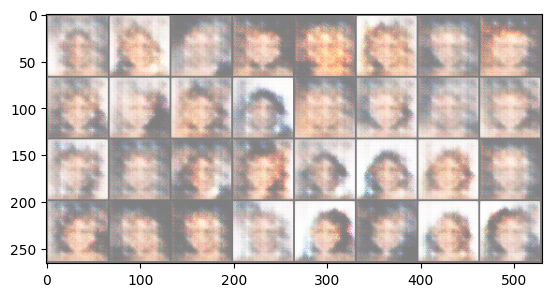

Epoch [0/5] Batch 350/1583                   Loss D: 0.5509, loss G: 1.9030


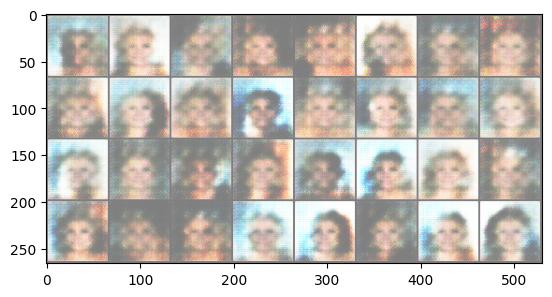

Epoch [0/5] Batch 400/1583                   Loss D: 0.5851, loss G: 1.6381


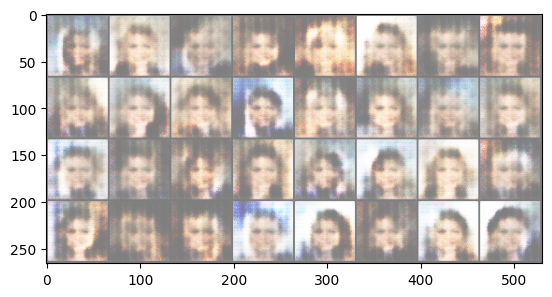

Epoch [0/5] Batch 450/1583                   Loss D: 0.5929, loss G: 1.1207


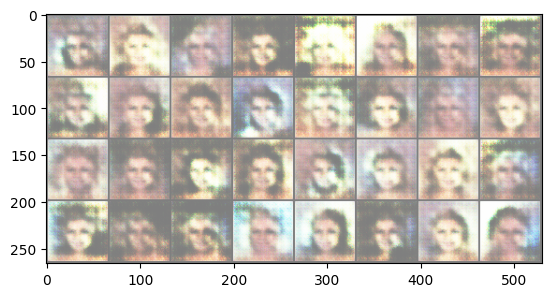

Epoch [0/5] Batch 500/1583                   Loss D: 0.6451, loss G: 2.1364


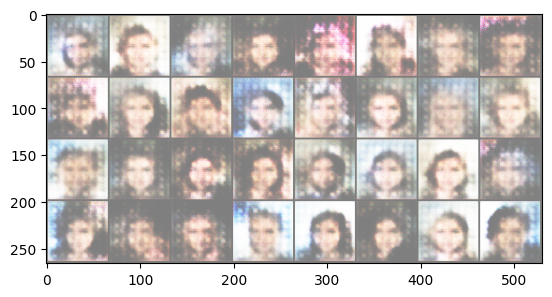

Epoch [0/5] Batch 550/1583                   Loss D: 0.4859, loss G: 1.8185


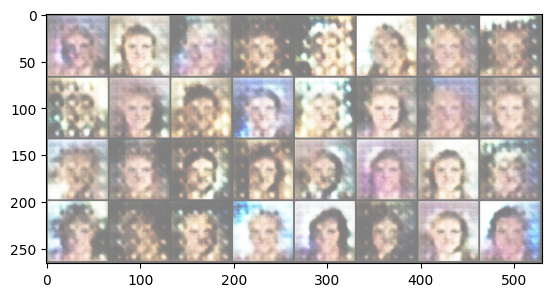

Epoch [0/5] Batch 600/1583                   Loss D: 0.7140, loss G: 1.2140


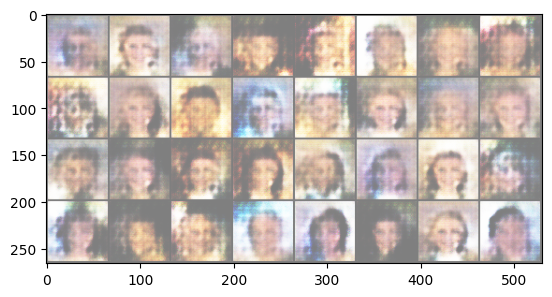

Epoch [0/5] Batch 650/1583                   Loss D: 0.5659, loss G: 1.5830


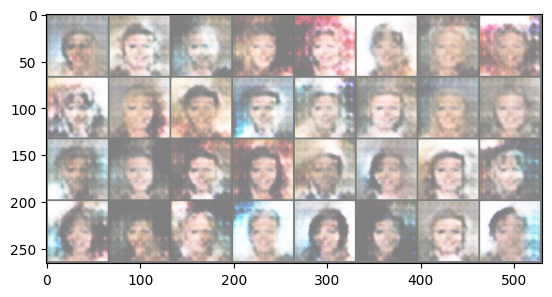

Epoch [0/5] Batch 700/1583                   Loss D: 0.4778, loss G: 1.8136


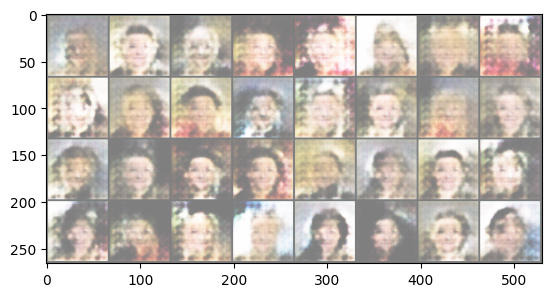

Epoch [0/5] Batch 750/1583                   Loss D: 0.4824, loss G: 2.0094


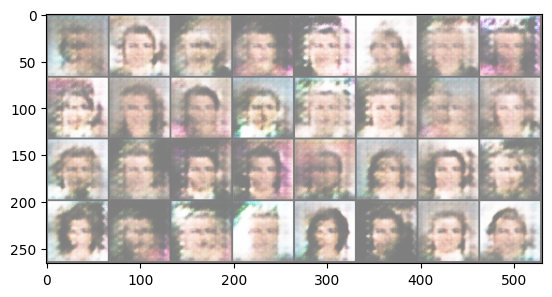

Epoch [0/5] Batch 800/1583                   Loss D: 0.5702, loss G: 2.9025


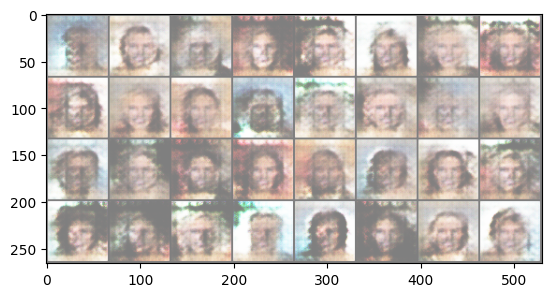

Epoch [0/5] Batch 850/1583                   Loss D: 0.5351, loss G: 2.1468


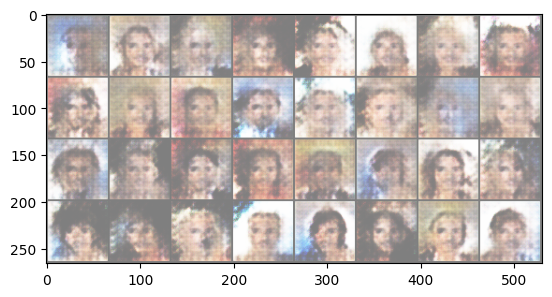

Epoch [0/5] Batch 900/1583                   Loss D: 0.2192, loss G: 2.8702


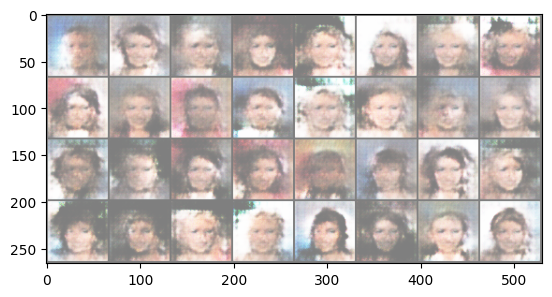

Epoch [0/5] Batch 950/1583                   Loss D: 0.2673, loss G: 3.0587


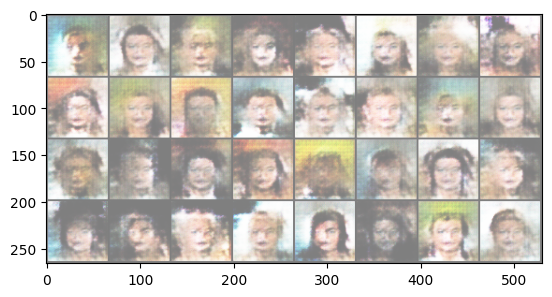

Epoch [0/5] Batch 1000/1583                   Loss D: 0.2994, loss G: 2.3469


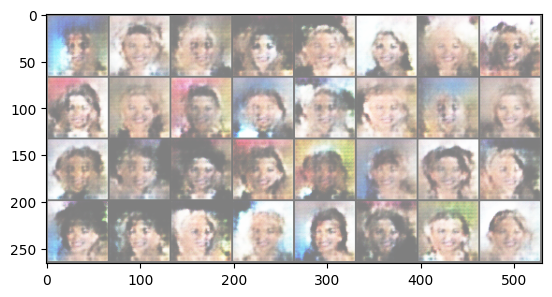

Epoch [0/5] Batch 1050/1583                   Loss D: 0.8194, loss G: 3.9674


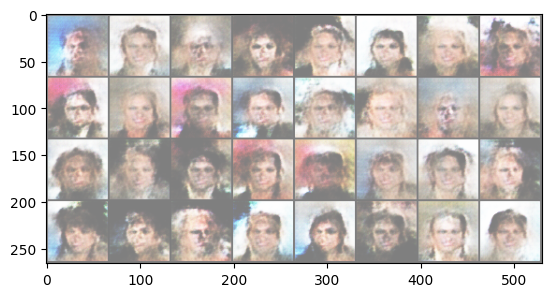

Epoch [0/5] Batch 1100/1583                   Loss D: 0.4851, loss G: 2.7056


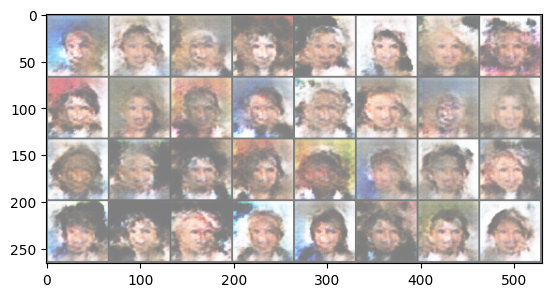

Epoch [0/5] Batch 1150/1583                   Loss D: 0.3458, loss G: 3.0580


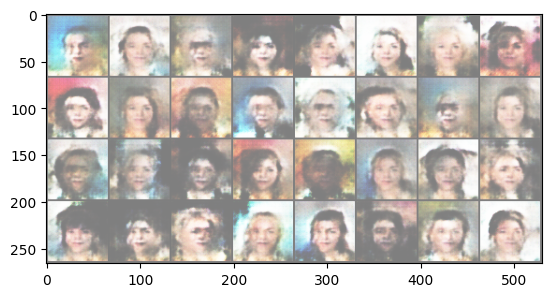

Epoch [0/5] Batch 1200/1583                   Loss D: 1.3768, loss G: 3.7671


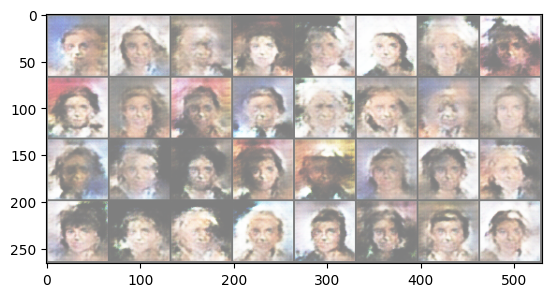

Epoch [0/5] Batch 1250/1583                   Loss D: 1.2835, loss G: 7.7091


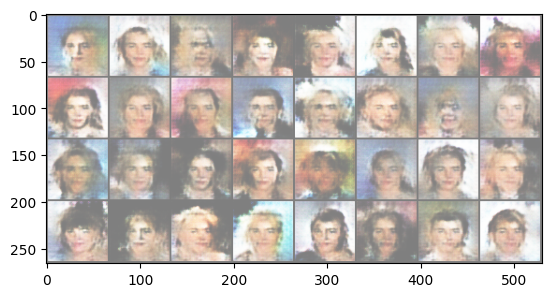

Epoch [0/5] Batch 1300/1583                   Loss D: 0.2492, loss G: 2.6856


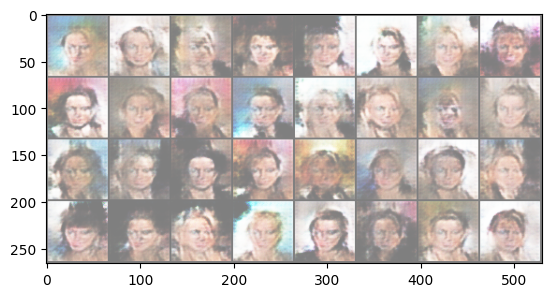

Epoch [0/5] Batch 1350/1583                   Loss D: 0.3153, loss G: 3.2202


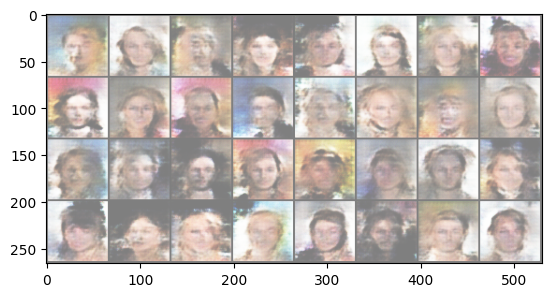

Epoch [0/5] Batch 1400/1583                   Loss D: 0.2204, loss G: 3.1161


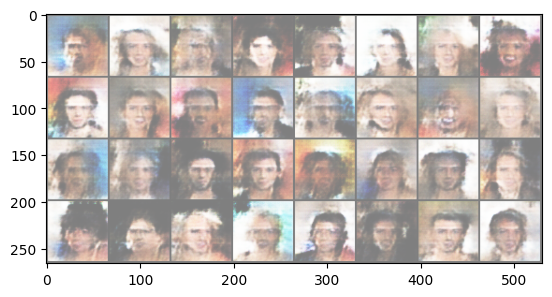

Epoch [0/5] Batch 1450/1583                   Loss D: 0.8990, loss G: 6.2101


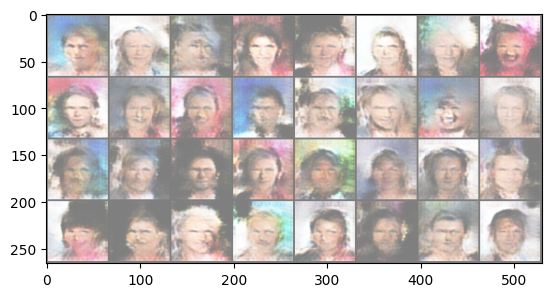

Epoch [0/5] Batch 1500/1583                   Loss D: 0.1721, loss G: 3.1623


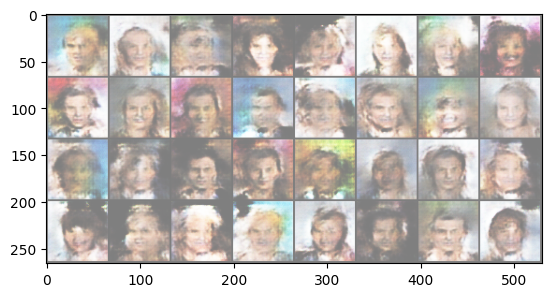

Epoch [0/5] Batch 1550/1583                   Loss D: 0.3765, loss G: 5.0943


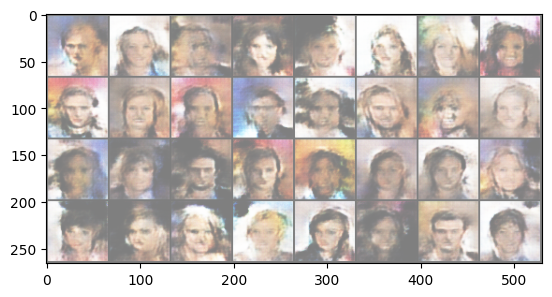

Epoch [1/5] Batch 0/1583                   Loss D: 0.2324, loss G: 2.0394


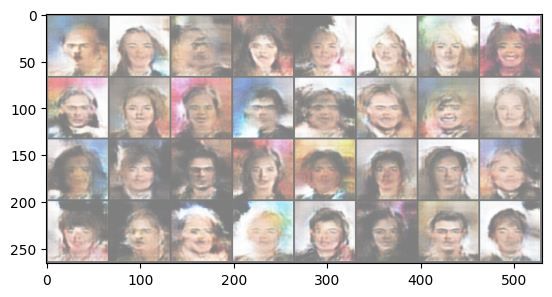

Epoch [1/5] Batch 50/1583                   Loss D: 0.3216, loss G: 6.3944


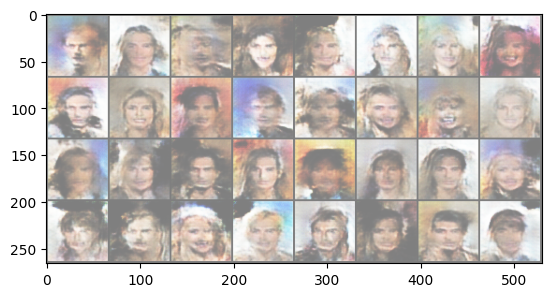

Epoch [1/5] Batch 100/1583                   Loss D: 0.2202, loss G: 3.8976


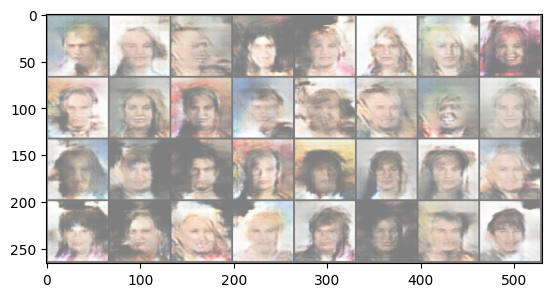

Epoch [1/5] Batch 150/1583                   Loss D: 0.0793, loss G: 3.6684


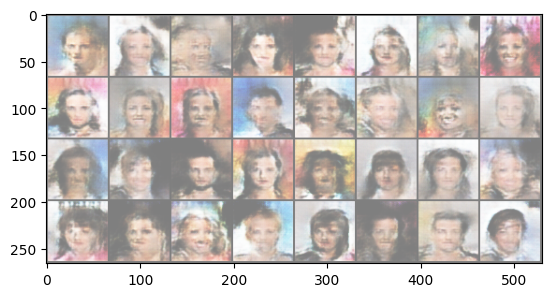

Epoch [1/5] Batch 200/1583                   Loss D: 0.1535, loss G: 3.0442


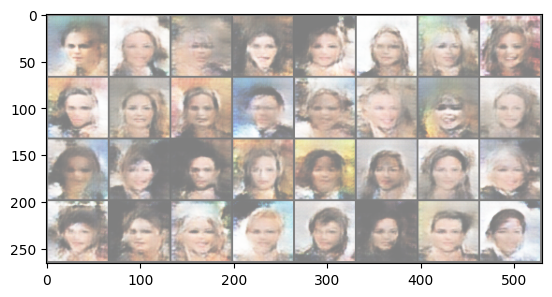

Epoch [1/5] Batch 250/1583                   Loss D: 0.3960, loss G: 3.2080


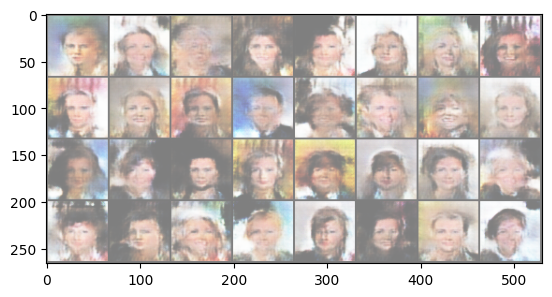

Epoch [1/5] Batch 300/1583                   Loss D: 0.4131, loss G: 2.4737


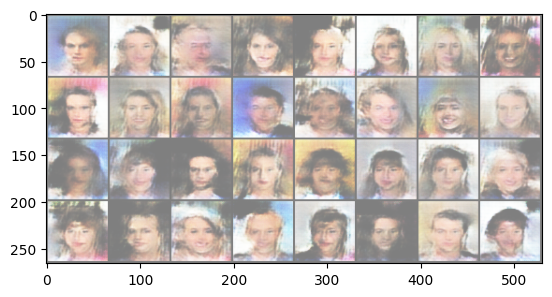

Epoch [1/5] Batch 350/1583                   Loss D: 0.2728, loss G: 3.4901


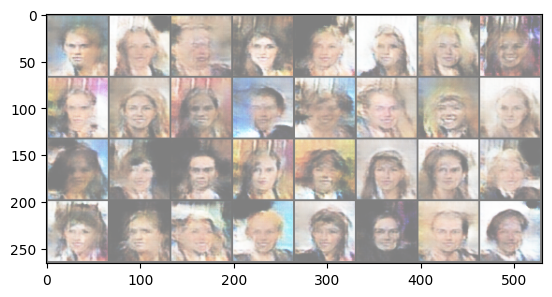

Epoch [1/5] Batch 400/1583                   Loss D: 1.1924, loss G: 7.0678


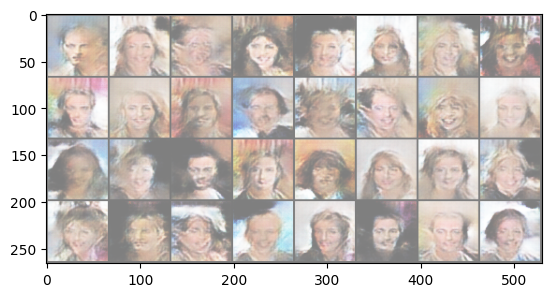

Epoch [1/5] Batch 450/1583                   Loss D: 0.3151, loss G: 4.5019


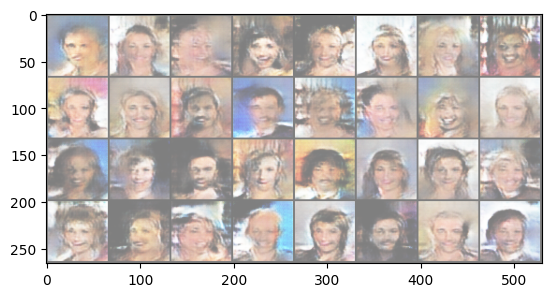

Epoch [1/5] Batch 500/1583                   Loss D: 0.1475, loss G: 4.2152


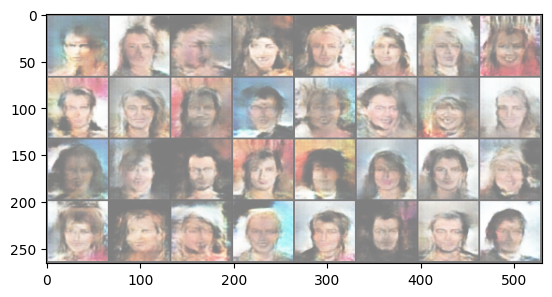

Epoch [1/5] Batch 550/1583                   Loss D: 0.3887, loss G: 4.4916


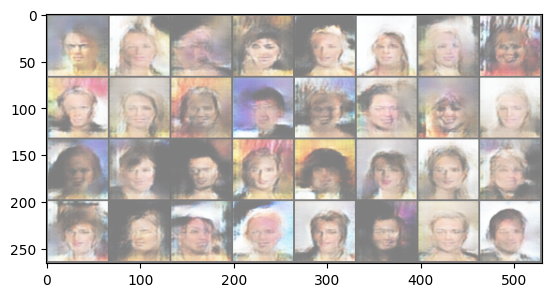

Epoch [1/5] Batch 600/1583                   Loss D: 0.1253, loss G: 2.5582


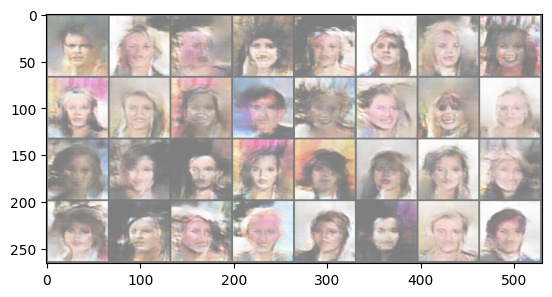

Epoch [1/5] Batch 650/1583                   Loss D: 0.3484, loss G: 5.5027


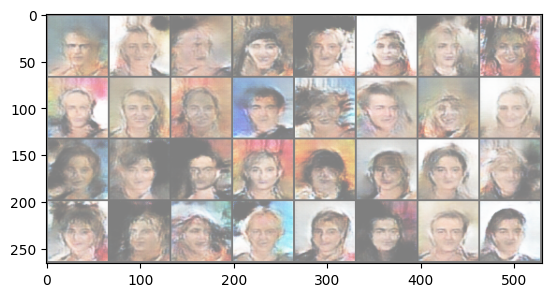

Epoch [1/5] Batch 700/1583                   Loss D: 0.0927, loss G: 2.6233


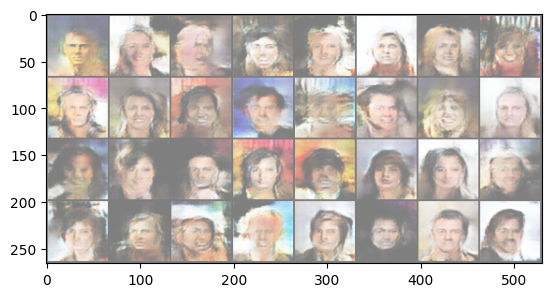

Epoch [1/5] Batch 750/1583                   Loss D: 1.4095, loss G: 5.3464


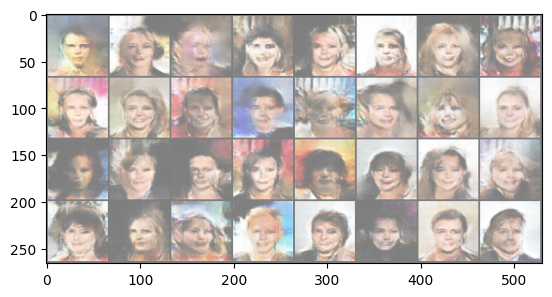

Epoch [1/5] Batch 800/1583                   Loss D: 0.2232, loss G: 2.7758


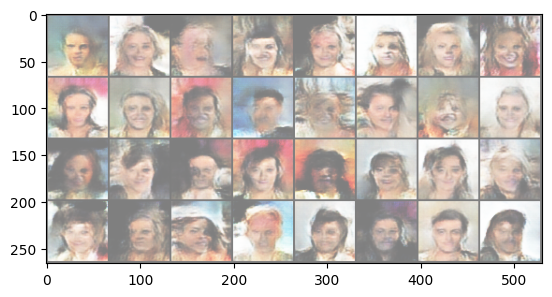

Epoch [1/5] Batch 850/1583                   Loss D: 0.2076, loss G: 3.3136


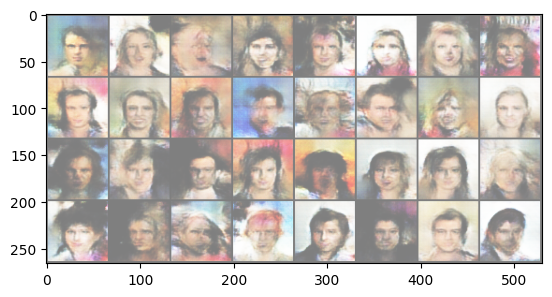

Epoch [1/5] Batch 900/1583                   Loss D: 0.0667, loss G: 3.2581


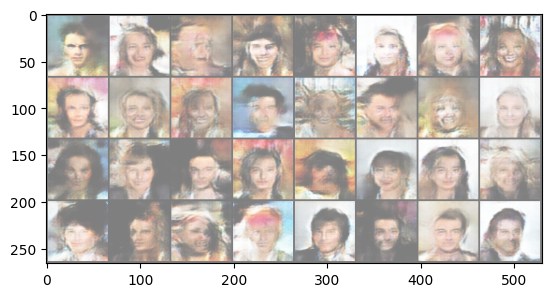

Epoch [1/5] Batch 950/1583                   Loss D: 0.2645, loss G: 4.2166


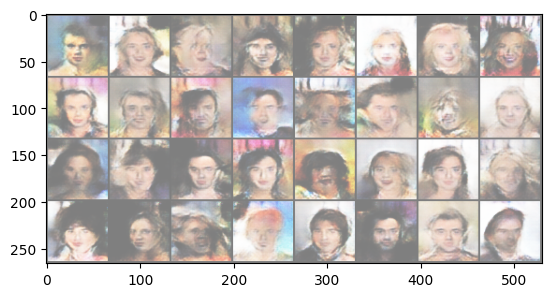

Epoch [1/5] Batch 1000/1583                   Loss D: 0.3772, loss G: 7.4057


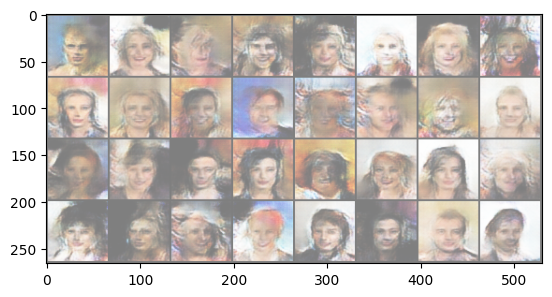

Epoch [1/5] Batch 1050/1583                   Loss D: 0.1712, loss G: 4.6202


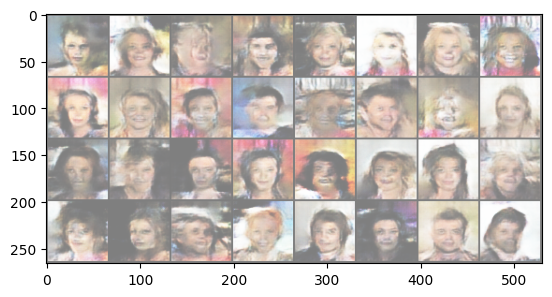

Epoch [1/5] Batch 1100/1583                   Loss D: 0.1919, loss G: 3.4919


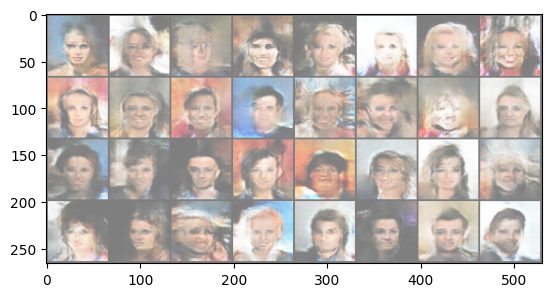

Epoch [1/5] Batch 1150/1583                   Loss D: 0.0320, loss G: 3.3221


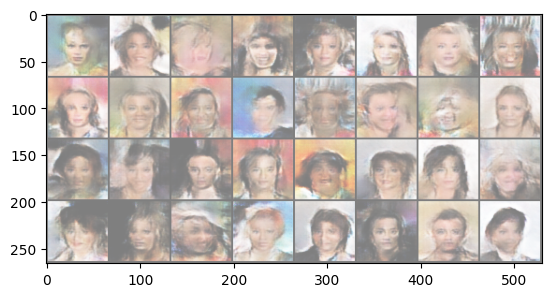

Epoch [1/5] Batch 1200/1583                   Loss D: 0.1346, loss G: 2.5605


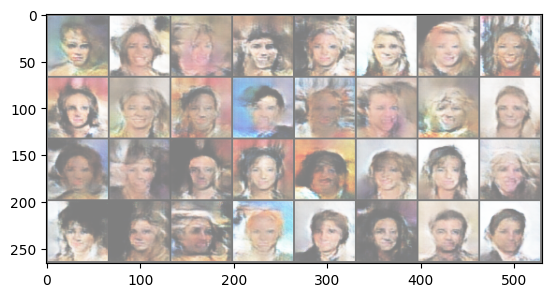

Epoch [1/5] Batch 1250/1583                   Loss D: 0.2035, loss G: 3.6967


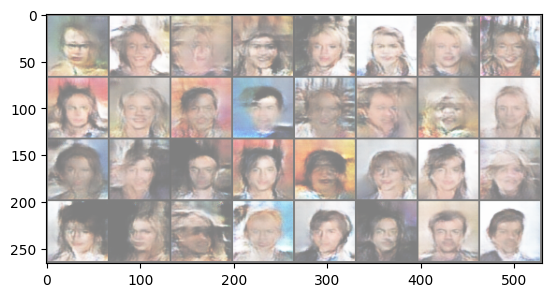

Epoch [1/5] Batch 1300/1583                   Loss D: 0.5456, loss G: 1.9631


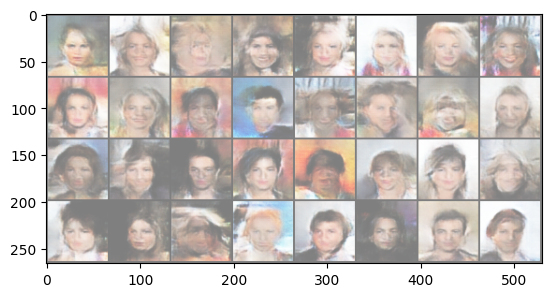

Epoch [1/5] Batch 1350/1583                   Loss D: 0.0866, loss G: 3.3501


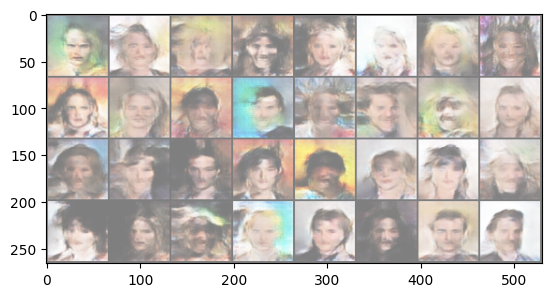

Epoch [1/5] Batch 1400/1583                   Loss D: 0.1931, loss G: 2.9117


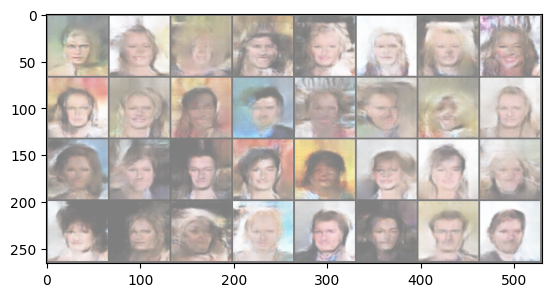

Epoch [1/5] Batch 1450/1583                   Loss D: 0.1579, loss G: 2.9148


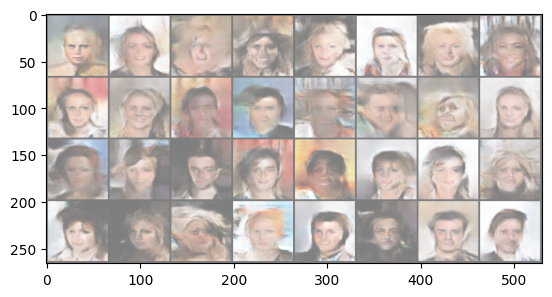

Epoch [1/5] Batch 1500/1583                   Loss D: 0.2473, loss G: 4.5975


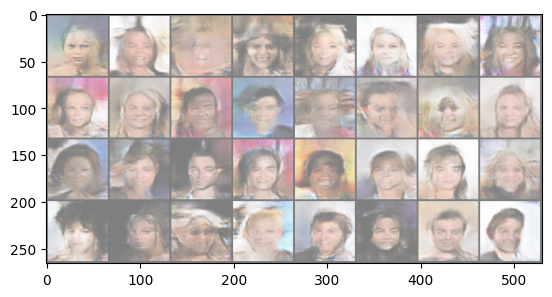

Epoch [1/5] Batch 1550/1583                   Loss D: 0.0826, loss G: 3.1070


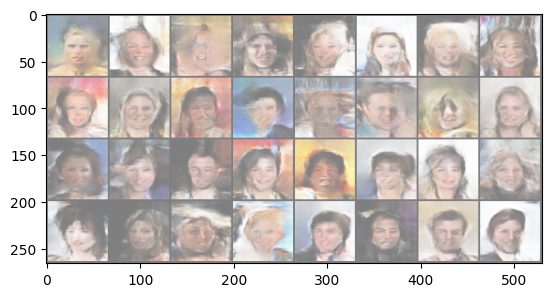

Epoch [2/5] Batch 0/1583                   Loss D: 0.1981, loss G: 3.8492


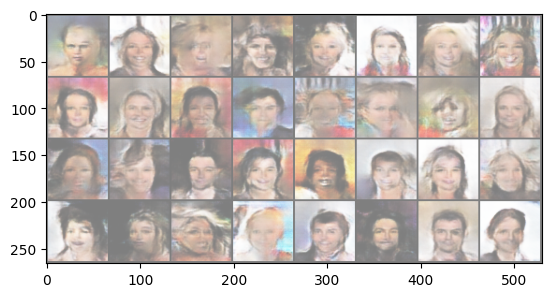

Epoch [2/5] Batch 50/1583                   Loss D: 0.2108, loss G: 3.1386


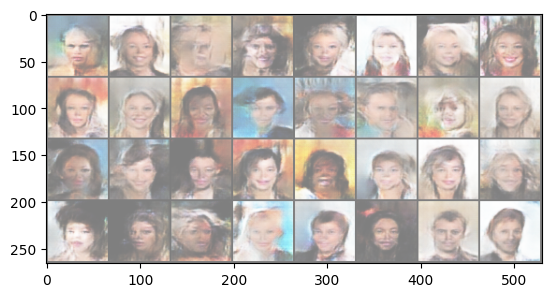

Epoch [2/5] Batch 100/1583                   Loss D: 0.5071, loss G: 3.2402


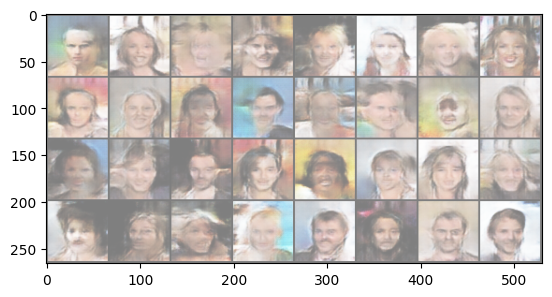

Epoch [2/5] Batch 150/1583                   Loss D: 0.0874, loss G: 2.8244


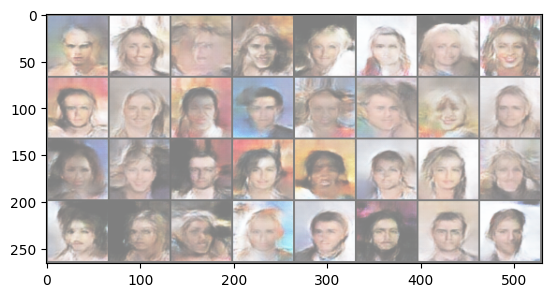

Epoch [2/5] Batch 200/1583                   Loss D: 0.2522, loss G: 3.0460


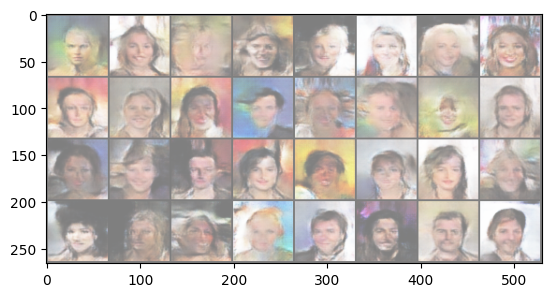

Epoch [2/5] Batch 250/1583                   Loss D: 0.1499, loss G: 3.5683


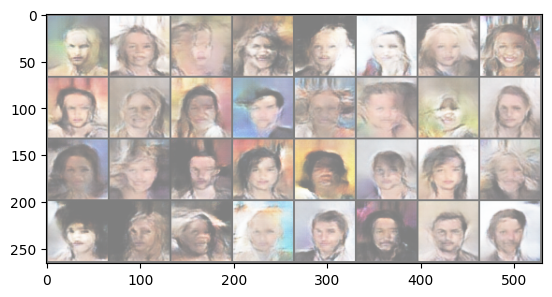

Epoch [2/5] Batch 300/1583                   Loss D: 0.4010, loss G: 8.1884


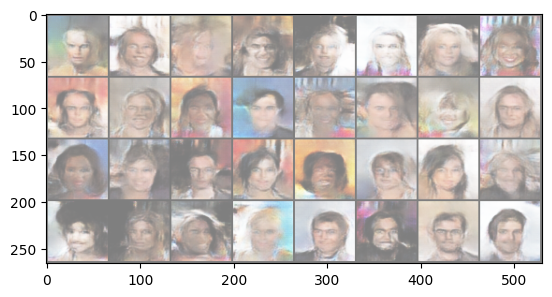

Epoch [2/5] Batch 350/1583                   Loss D: 0.1520, loss G: 2.4956


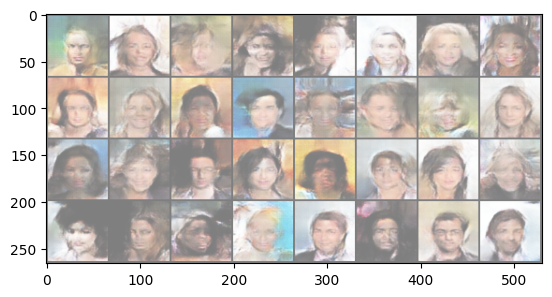

Epoch [2/5] Batch 400/1583                   Loss D: 0.2198, loss G: 2.5803


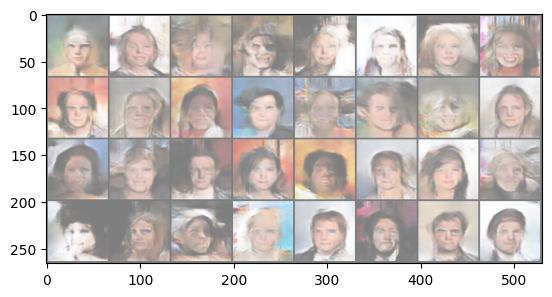

Epoch [2/5] Batch 450/1583                   Loss D: 0.1476, loss G: 2.9951


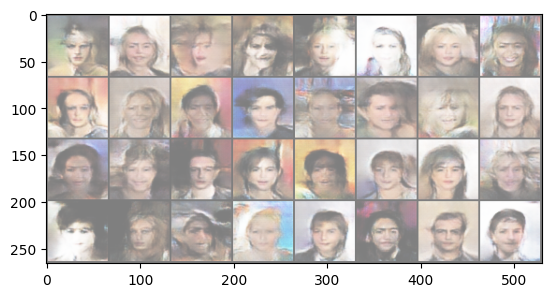

Epoch [2/5] Batch 500/1583                   Loss D: 0.2279, loss G: 5.1068


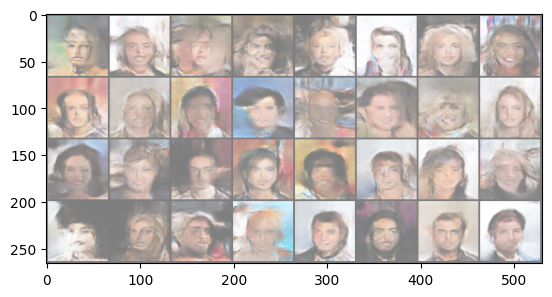

Epoch [2/5] Batch 550/1583                   Loss D: 0.0097, loss G: 4.4294


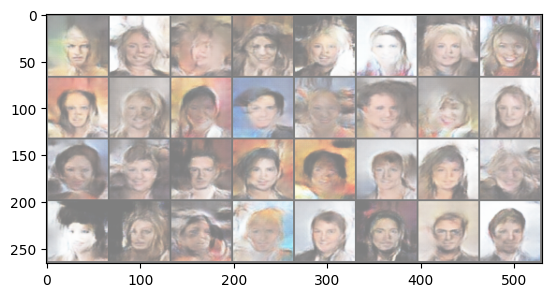

Epoch [2/5] Batch 600/1583                   Loss D: 0.5455, loss G: 4.5376


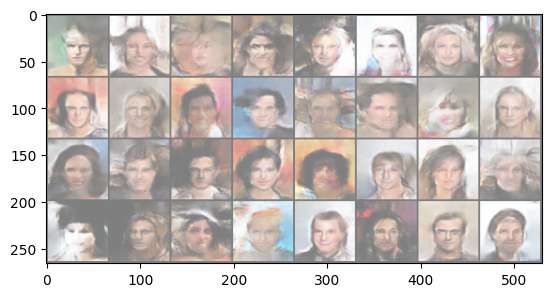

Epoch [2/5] Batch 650/1583                   Loss D: 0.0884, loss G: 3.9236


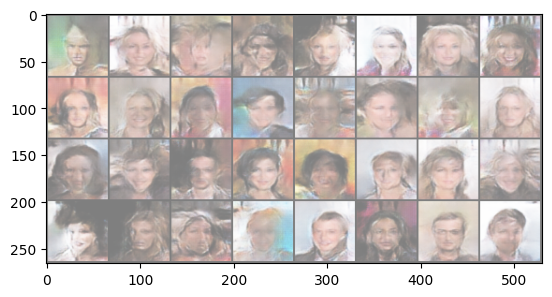

Epoch [2/5] Batch 700/1583                   Loss D: 0.2441, loss G: 2.0734


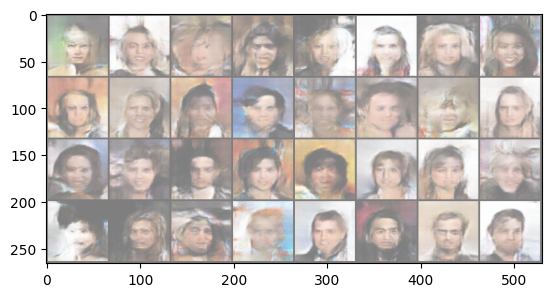

Epoch [2/5] Batch 750/1583                   Loss D: 0.1687, loss G: 3.9408


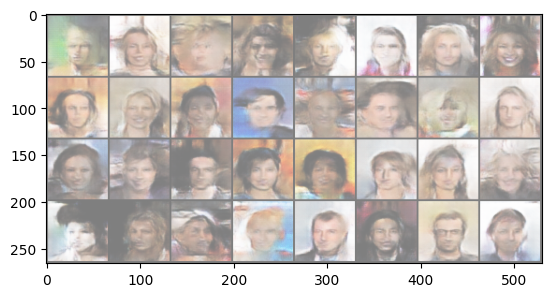

Epoch [2/5] Batch 800/1583                   Loss D: 0.1418, loss G: 3.4121


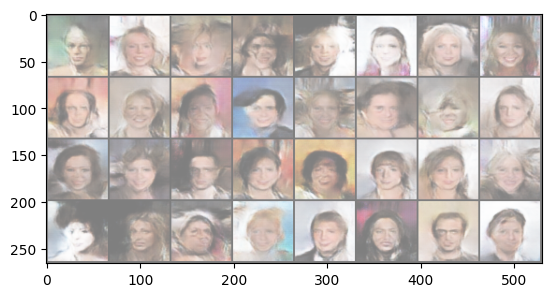

Epoch [2/5] Batch 850/1583                   Loss D: 0.0446, loss G: 3.7455


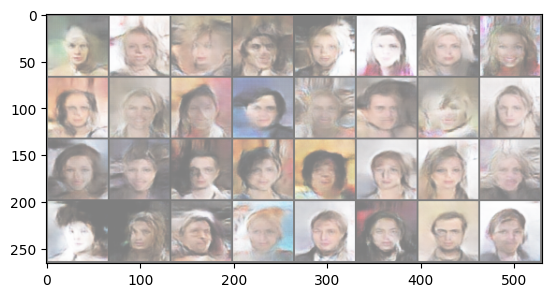

Epoch [2/5] Batch 900/1583                   Loss D: 0.3154, loss G: 4.9197


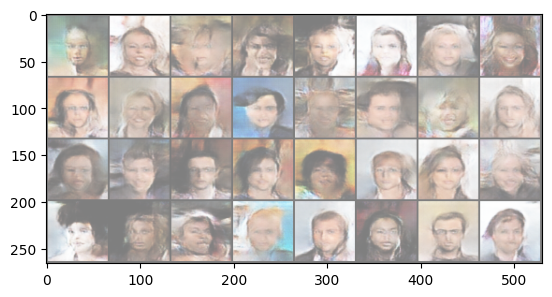

Epoch [2/5] Batch 950/1583                   Loss D: 0.0929, loss G: 2.7912


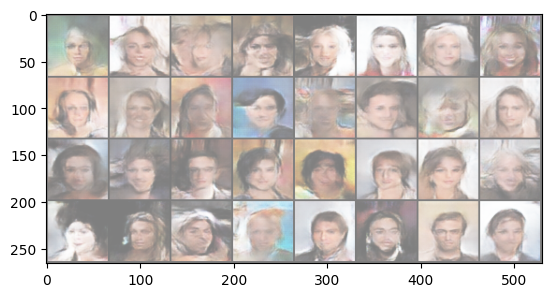

Epoch [2/5] Batch 1000/1583                   Loss D: 0.7371, loss G: 2.3512


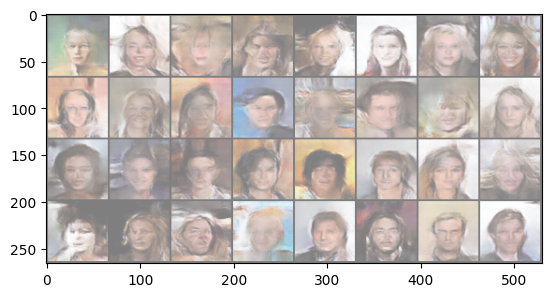

Epoch [2/5] Batch 1050/1583                   Loss D: 0.1166, loss G: 4.2425


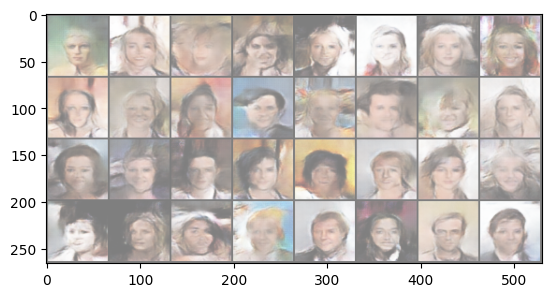

Epoch [2/5] Batch 1100/1583                   Loss D: 0.2578, loss G: 4.5169


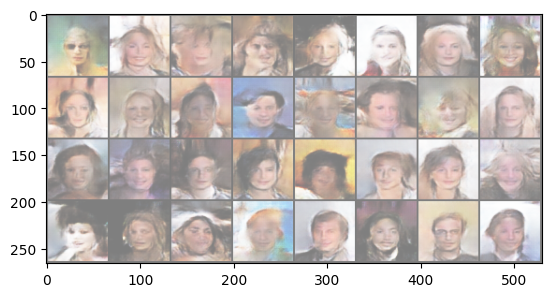

Epoch [2/5] Batch 1150/1583                   Loss D: 0.3104, loss G: 3.9637


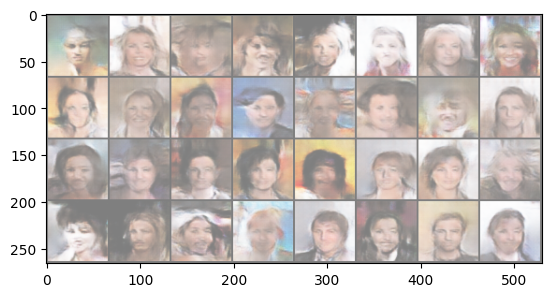

Epoch [2/5] Batch 1200/1583                   Loss D: 0.1373, loss G: 2.6794


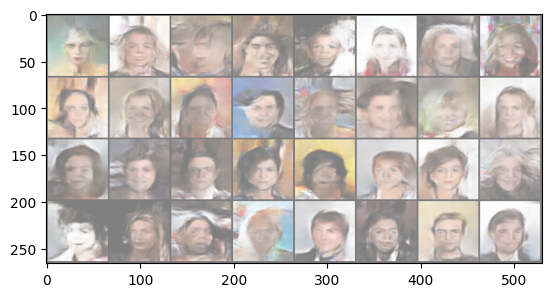

Epoch [2/5] Batch 1250/1583                   Loss D: 0.1779, loss G: 3.8100


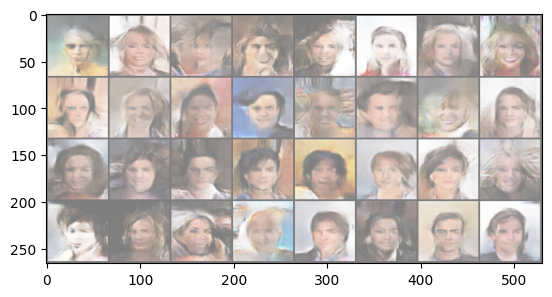

Epoch [2/5] Batch 1300/1583                   Loss D: 0.1339, loss G: 6.1303


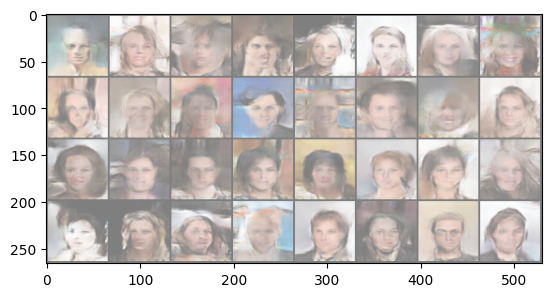

Epoch [2/5] Batch 1350/1583                   Loss D: 0.2167, loss G: 4.7219


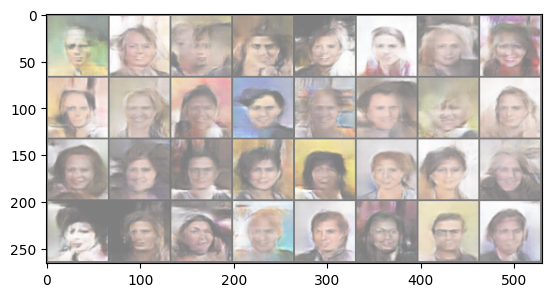

Epoch [2/5] Batch 1400/1583                   Loss D: 0.1515, loss G: 3.0165


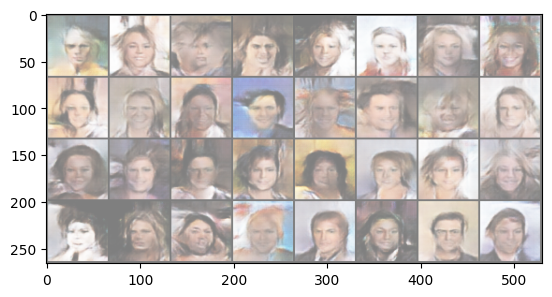

Epoch [2/5] Batch 1450/1583                   Loss D: 0.2815, loss G: 4.7602


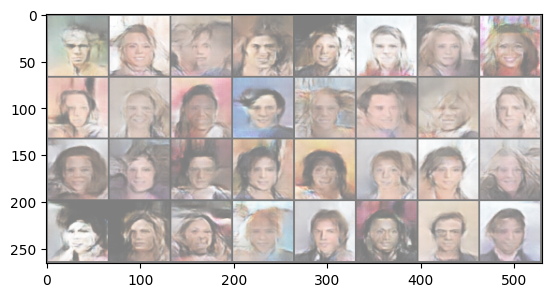

Epoch [2/5] Batch 1500/1583                   Loss D: 0.0948, loss G: 3.2629


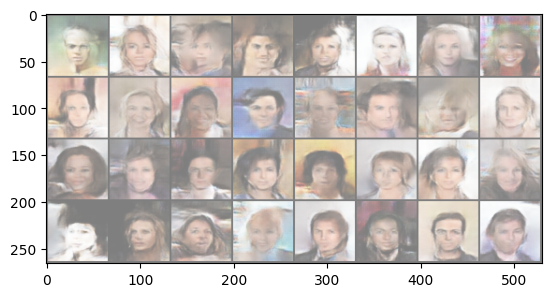

Epoch [2/5] Batch 1550/1583                   Loss D: 0.1762, loss G: 3.0146


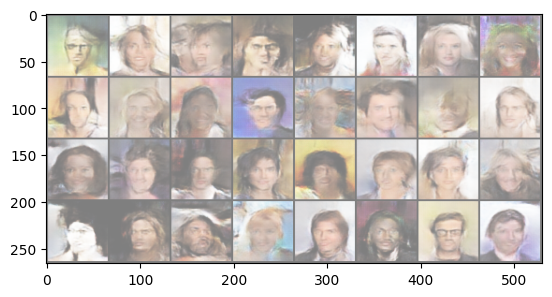

Epoch [3/5] Batch 0/1583                   Loss D: 0.0461, loss G: 3.6373


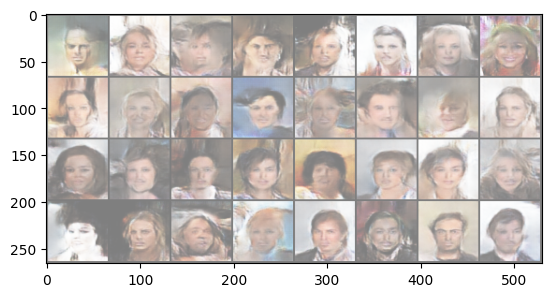

Epoch [3/5] Batch 50/1583                   Loss D: 0.0913, loss G: 3.5408


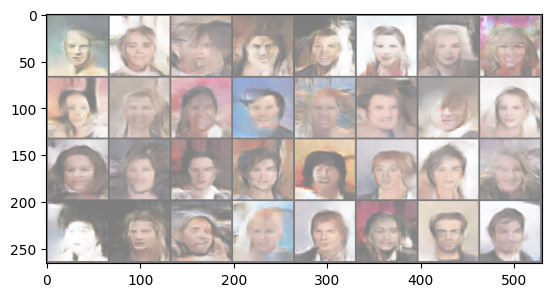

Epoch [3/5] Batch 100/1583                   Loss D: 0.2304, loss G: 5.9542


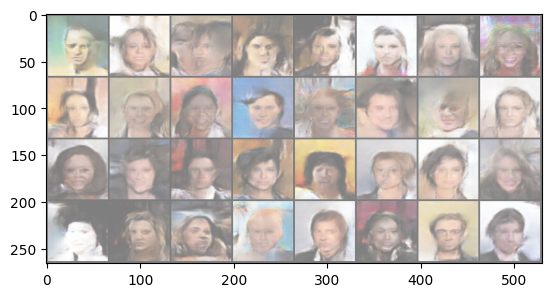

Epoch [3/5] Batch 150/1583                   Loss D: 0.3038, loss G: 6.0689


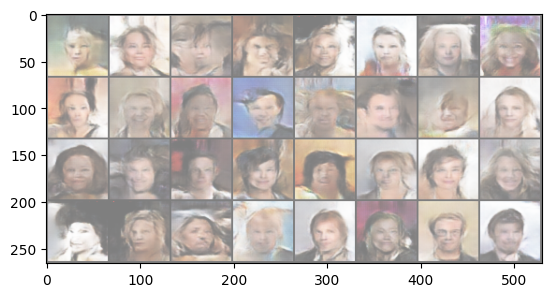

Epoch [3/5] Batch 200/1583                   Loss D: 0.1209, loss G: 3.4058


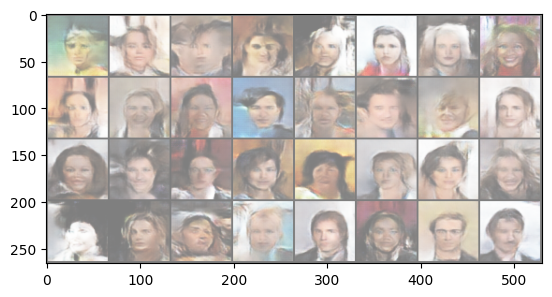

Epoch [3/5] Batch 250/1583                   Loss D: 0.2393, loss G: 2.8758


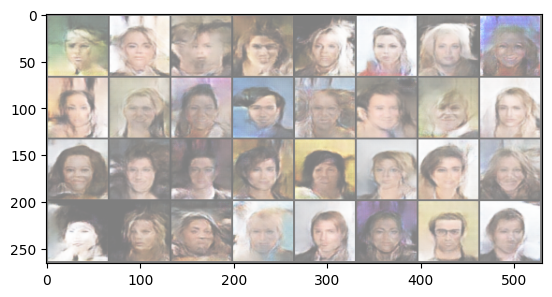

Epoch [3/5] Batch 300/1583                   Loss D: 0.1819, loss G: 2.9837


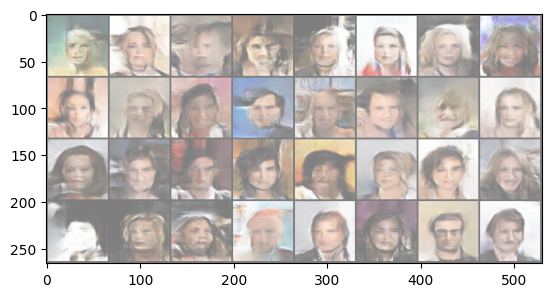

Epoch [3/5] Batch 350/1583                   Loss D: 0.0621, loss G: 3.2631


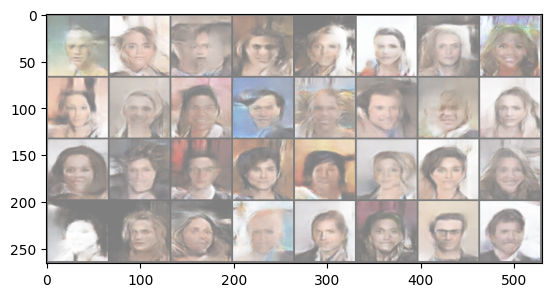

Epoch [3/5] Batch 400/1583                   Loss D: 0.4243, loss G: 3.5986


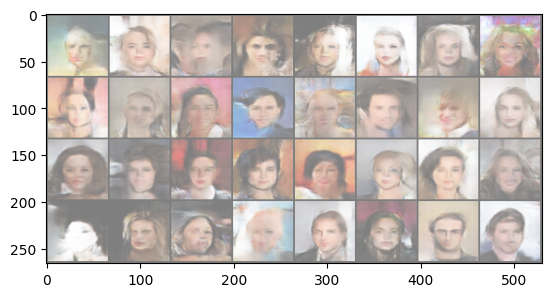

Epoch [3/5] Batch 450/1583                   Loss D: 0.1781, loss G: 3.7913


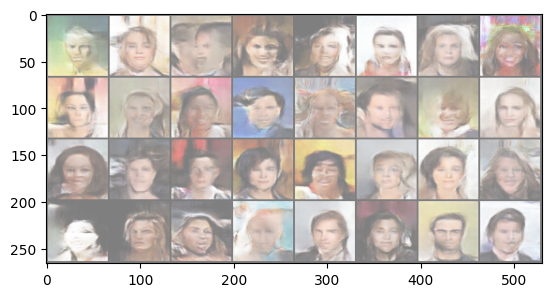

Epoch [3/5] Batch 500/1583                   Loss D: 0.1118, loss G: 3.4259


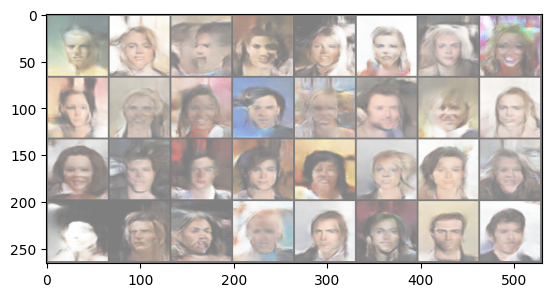

Epoch [3/5] Batch 550/1583                   Loss D: 0.8598, loss G: 9.8182


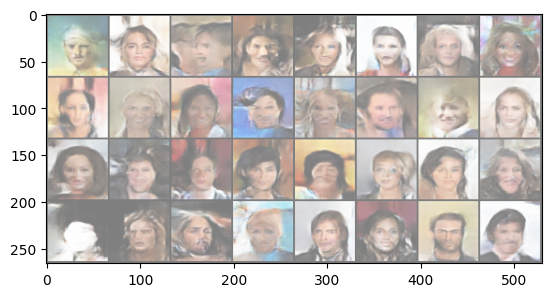

Epoch [3/5] Batch 600/1583                   Loss D: 0.1030, loss G: 3.0525


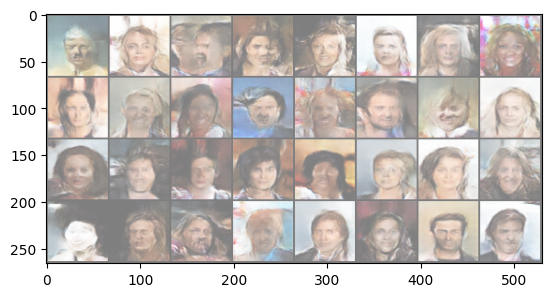

Epoch [3/5] Batch 650/1583                   Loss D: 0.0809, loss G: 3.8356


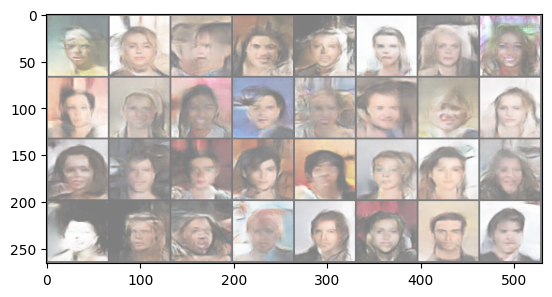

Epoch [3/5] Batch 700/1583                   Loss D: 0.1136, loss G: 3.3470


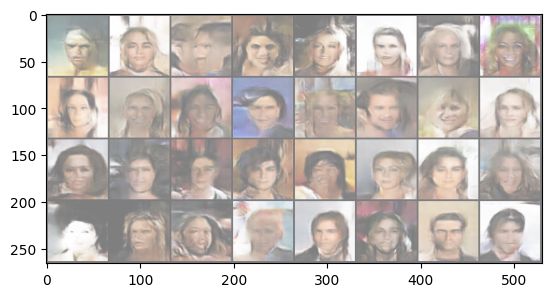

Epoch [3/5] Batch 750/1583                   Loss D: 0.4328, loss G: 3.0811


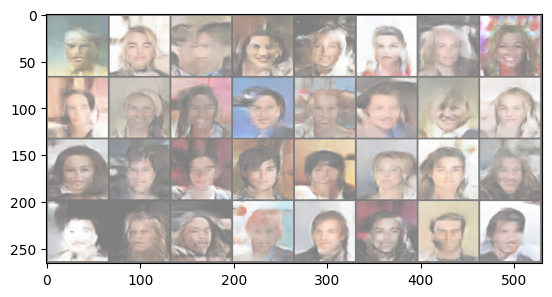

Epoch [3/5] Batch 800/1583                   Loss D: 0.5610, loss G: 2.0979


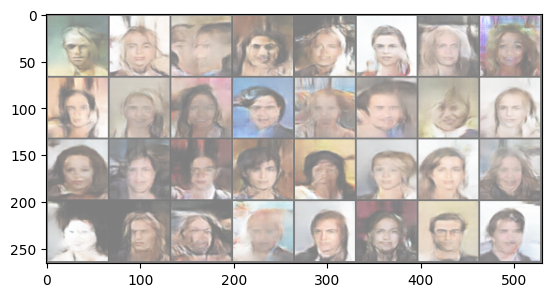

Epoch [3/5] Batch 850/1583                   Loss D: 0.1462, loss G: 4.1860


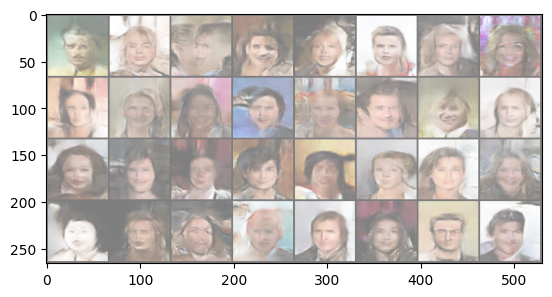

Epoch [3/5] Batch 900/1583                   Loss D: 0.1389, loss G: 3.3110


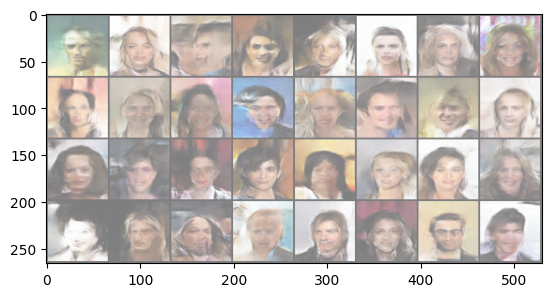

Epoch [3/5] Batch 950/1583                   Loss D: 0.1295, loss G: 3.8196


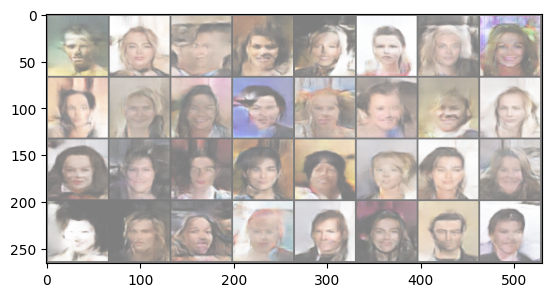

Epoch [3/5] Batch 1000/1583                   Loss D: 0.1241, loss G: 4.7753


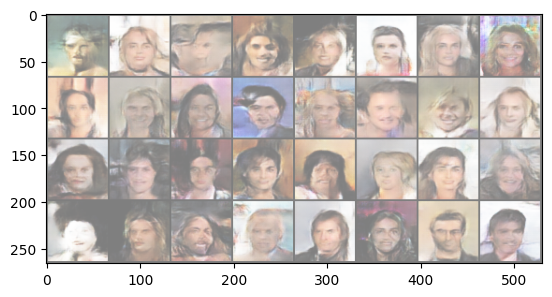

Epoch [3/5] Batch 1050/1583                   Loss D: 0.3876, loss G: 1.1870


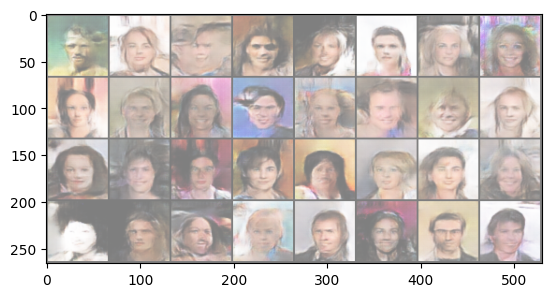

Epoch [3/5] Batch 1100/1583                   Loss D: 0.3003, loss G: 4.4849


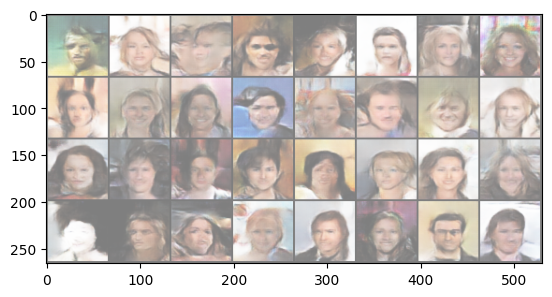

Epoch [3/5] Batch 1150/1583                   Loss D: 0.0995, loss G: 2.8287


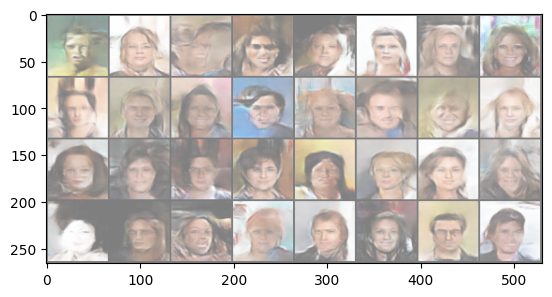

Epoch [3/5] Batch 1200/1583                   Loss D: 0.0934, loss G: 3.0981


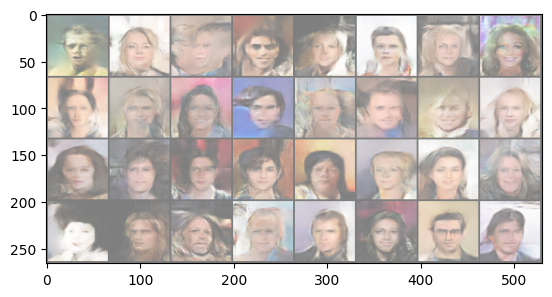

Epoch [3/5] Batch 1250/1583                   Loss D: 0.5973, loss G: 5.7219


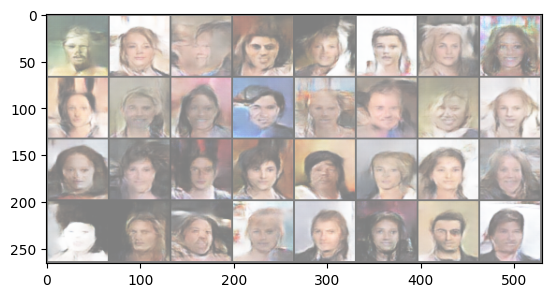

Epoch [3/5] Batch 1300/1583                   Loss D: 0.0413, loss G: 4.4903


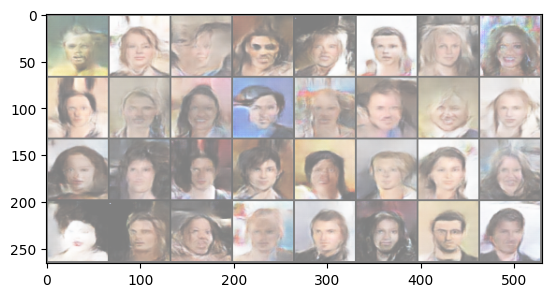

Epoch [3/5] Batch 1350/1583                   Loss D: 0.0774, loss G: 3.6217


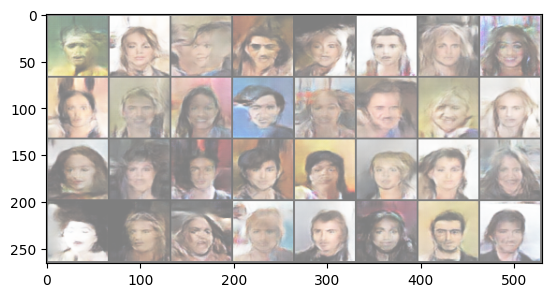

Epoch [3/5] Batch 1400/1583                   Loss D: 0.0672, loss G: 3.2977


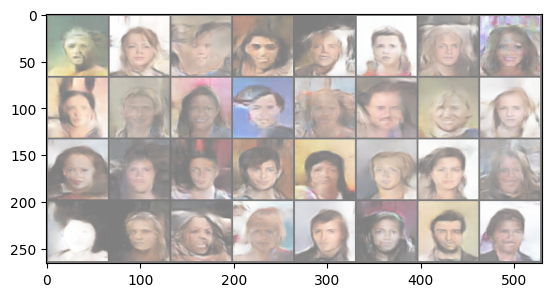

Epoch [3/5] Batch 1450/1583                   Loss D: 0.2899, loss G: 1.1558


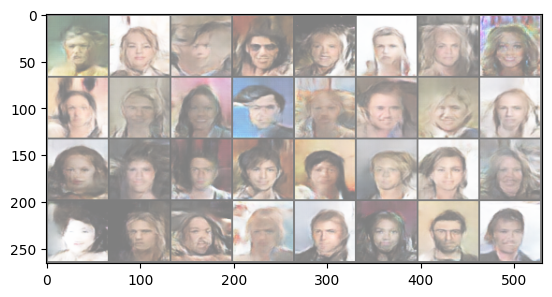

Epoch [3/5] Batch 1500/1583                   Loss D: 0.1324, loss G: 2.8351


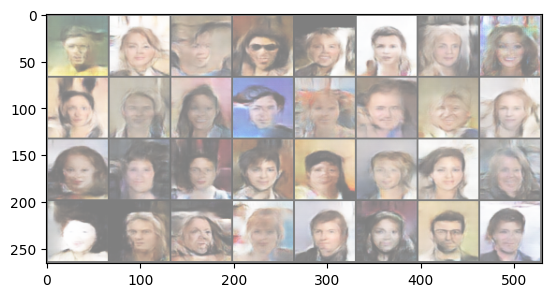

Epoch [3/5] Batch 1550/1583                   Loss D: 0.0266, loss G: 4.4533


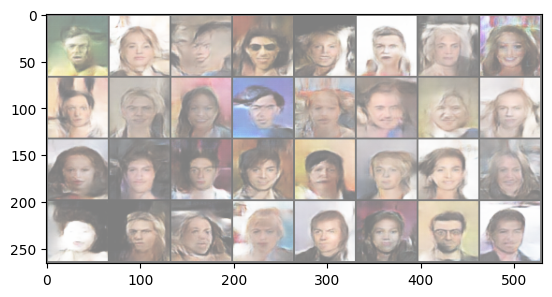

Epoch [4/5] Batch 0/1583                   Loss D: 0.6354, loss G: 10.7296


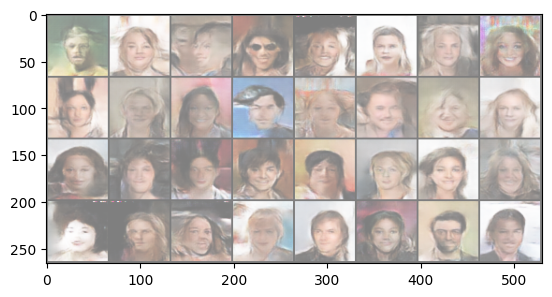

Epoch [4/5] Batch 50/1583                   Loss D: 0.4083, loss G: 3.1280


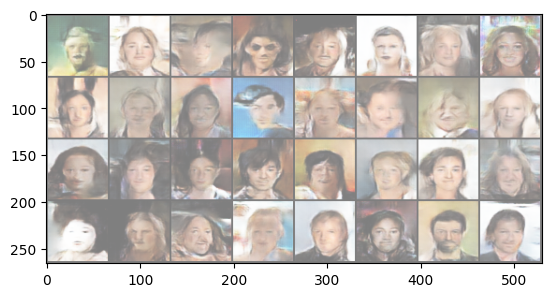

Epoch [4/5] Batch 100/1583                   Loss D: 0.6148, loss G: 7.8797


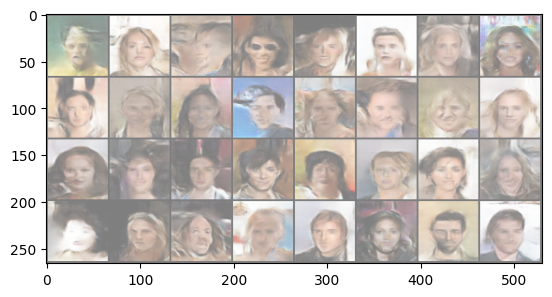

Epoch [4/5] Batch 150/1583                   Loss D: 0.2841, loss G: 6.3290


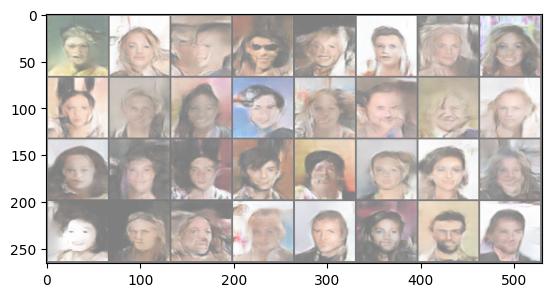

Epoch [4/5] Batch 200/1583                   Loss D: 0.0780, loss G: 3.6139


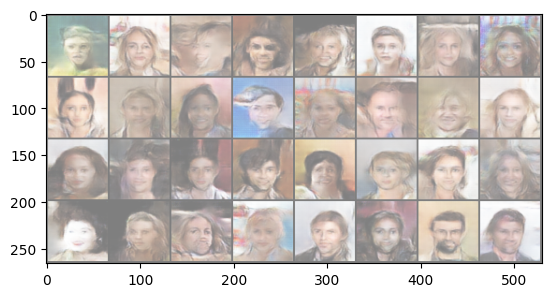

Epoch [4/5] Batch 250/1583                   Loss D: 0.2680, loss G: 1.6288


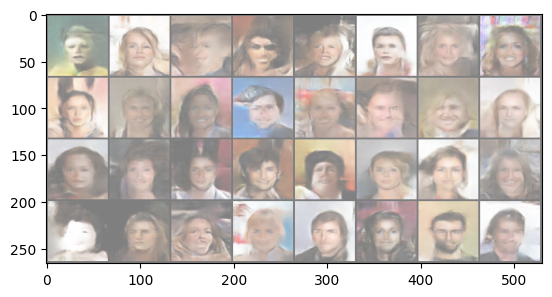

Epoch [4/5] Batch 300/1583                   Loss D: 0.0651, loss G: 2.4964


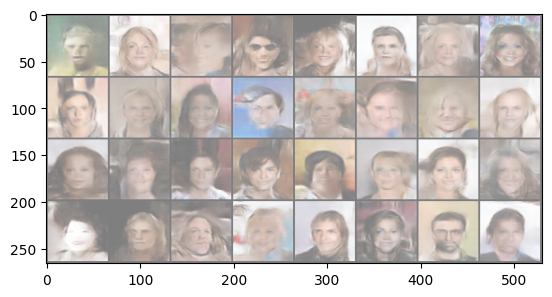

Epoch [4/5] Batch 350/1583                   Loss D: 0.1646, loss G: 5.5415


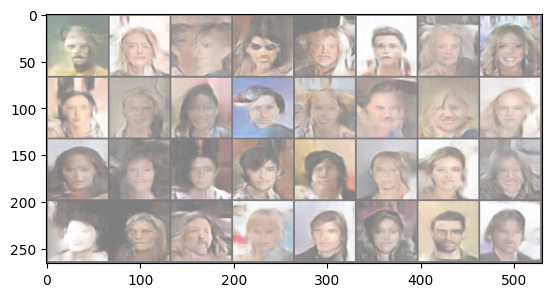

Epoch [4/5] Batch 400/1583                   Loss D: 0.1021, loss G: 3.5192


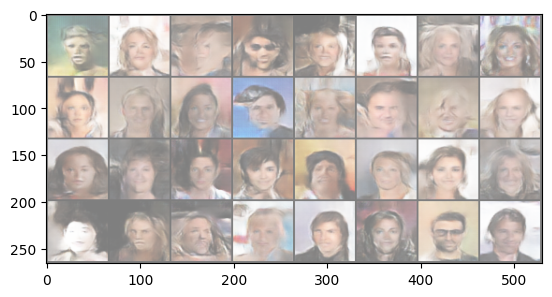

Epoch [4/5] Batch 450/1583                   Loss D: 0.2553, loss G: 3.2542


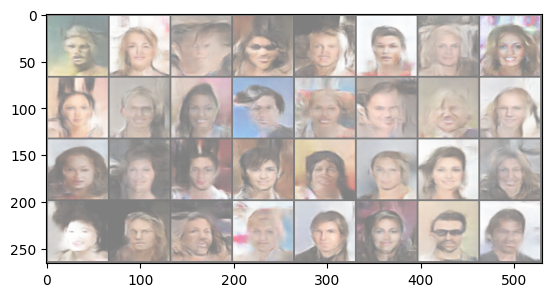

Epoch [4/5] Batch 500/1583                   Loss D: 0.1041, loss G: 3.8490


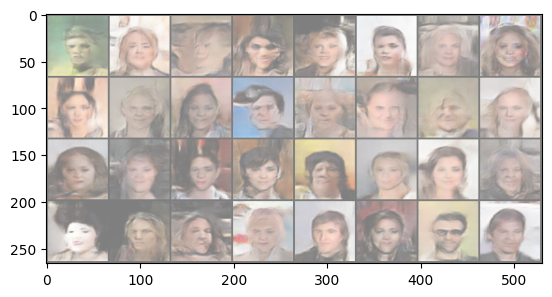

Epoch [4/5] Batch 550/1583                   Loss D: 0.0763, loss G: 4.4324


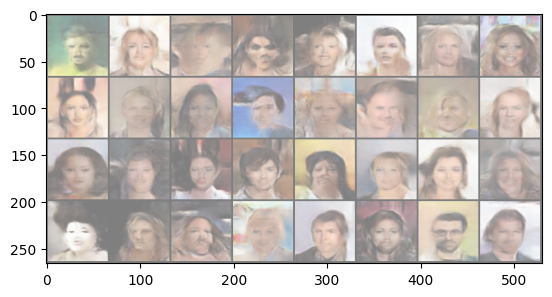

Epoch [4/5] Batch 600/1583                   Loss D: 0.1633, loss G: 4.1151


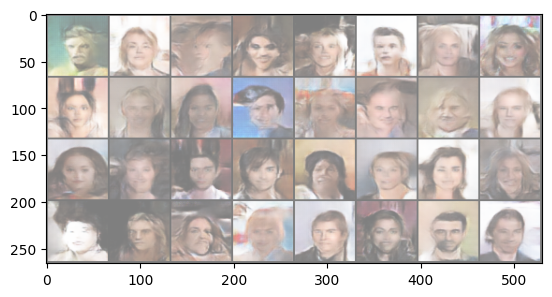

Epoch [4/5] Batch 650/1583                   Loss D: 0.1304, loss G: 4.6006


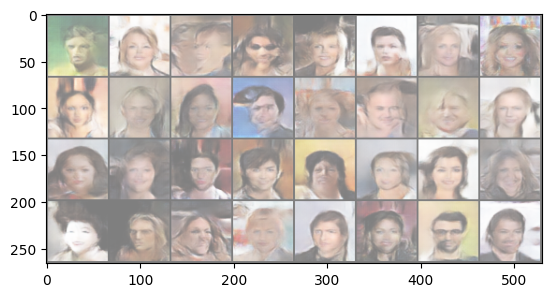

Epoch [4/5] Batch 700/1583                   Loss D: 0.0260, loss G: 3.2352


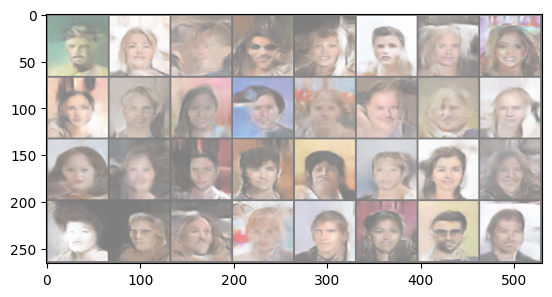

Epoch [4/5] Batch 750/1583                   Loss D: 0.2983, loss G: 2.4907


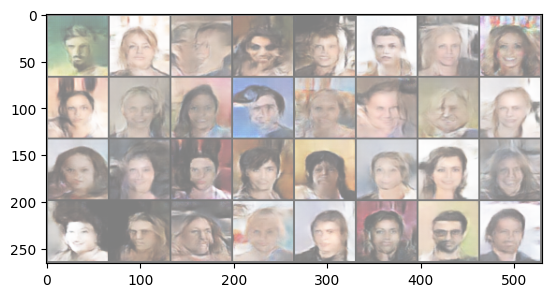

Epoch [4/5] Batch 800/1583                   Loss D: 0.4014, loss G: 1.3576


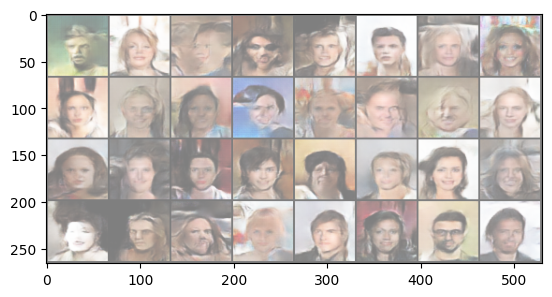

Epoch [4/5] Batch 850/1583                   Loss D: 0.0889, loss G: 4.0826


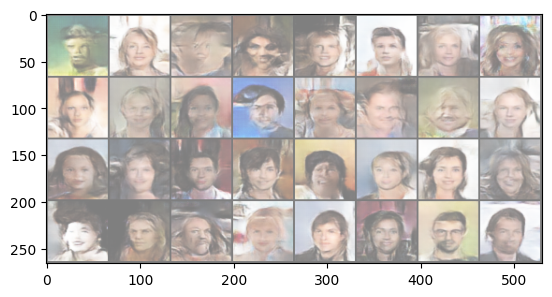

Epoch [4/5] Batch 900/1583                   Loss D: 0.1681, loss G: 4.5498


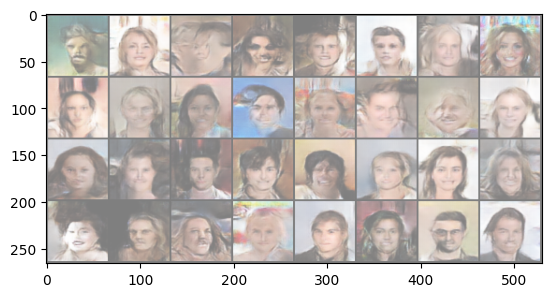

Epoch [4/5] Batch 950/1583                   Loss D: 0.1409, loss G: 3.0645


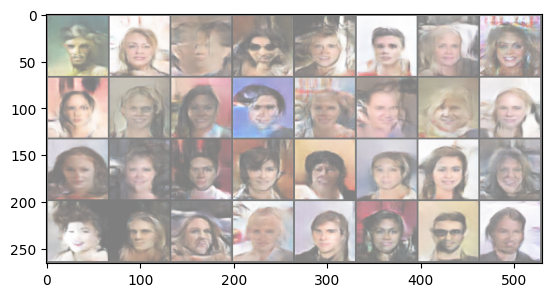

Epoch [4/5] Batch 1000/1583                   Loss D: 0.4298, loss G: 6.5213


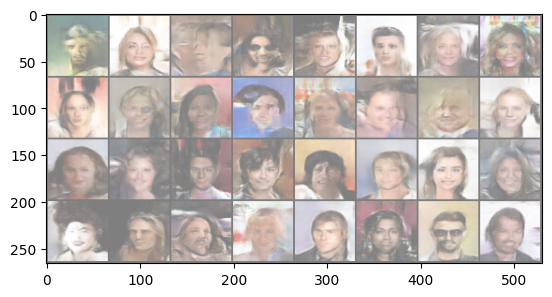

Epoch [4/5] Batch 1050/1583                   Loss D: 0.0924, loss G: 2.5295


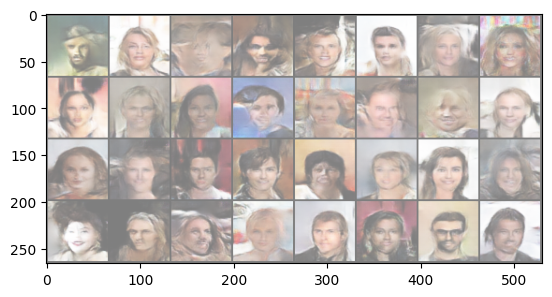

Epoch [4/5] Batch 1100/1583                   Loss D: 0.0871, loss G: 3.9100


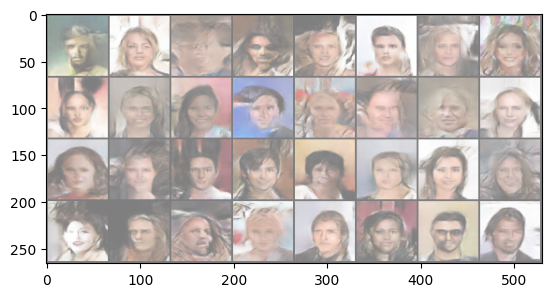

Epoch [4/5] Batch 1150/1583                   Loss D: 0.2331, loss G: 6.7136


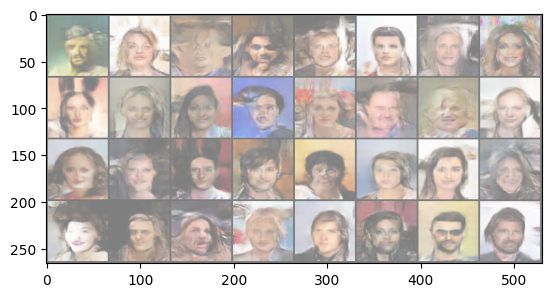

Epoch [4/5] Batch 1200/1583                   Loss D: 0.2461, loss G: 4.9701


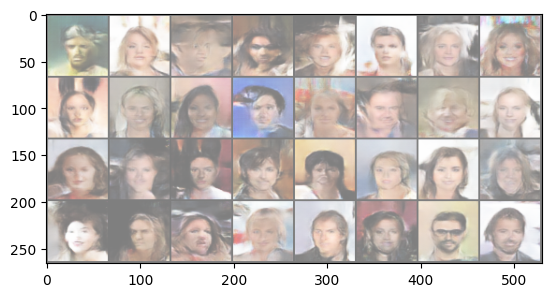

Epoch [4/5] Batch 1250/1583                   Loss D: 0.2739, loss G: 3.5546


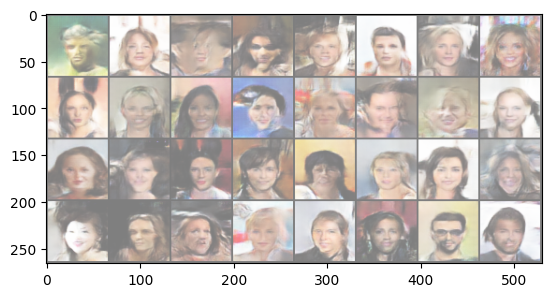

Epoch [4/5] Batch 1300/1583                   Loss D: 0.1382, loss G: 2.2272


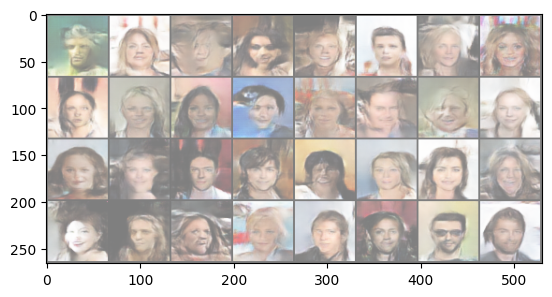

Epoch [4/5] Batch 1350/1583                   Loss D: 0.5129, loss G: 5.1926


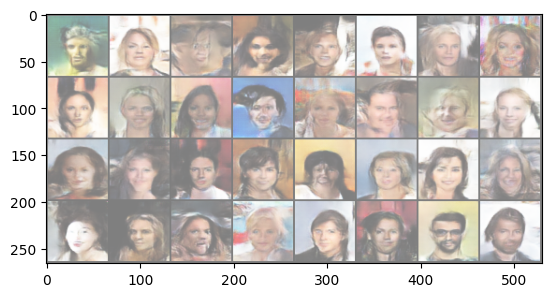

Epoch [4/5] Batch 1400/1583                   Loss D: 0.1005, loss G: 4.8990


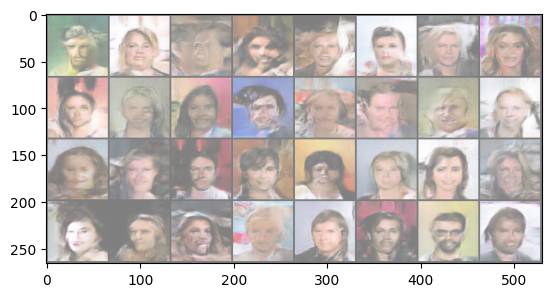

Epoch [4/5] Batch 1450/1583                   Loss D: 0.0536, loss G: 4.0734


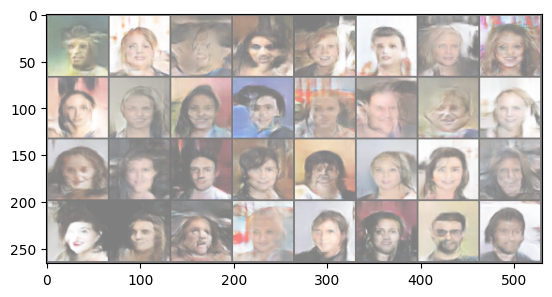

Epoch [4/5] Batch 1500/1583                   Loss D: 0.1810, loss G: 4.0619


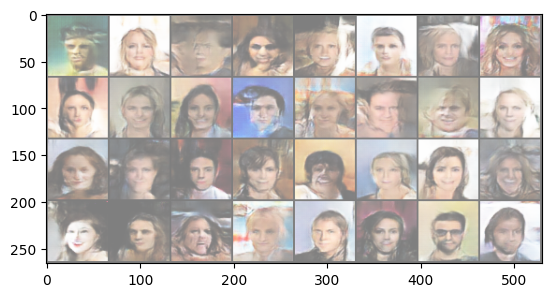

Epoch [4/5] Batch 1550/1583                   Loss D: 0.1779, loss G: 2.3465


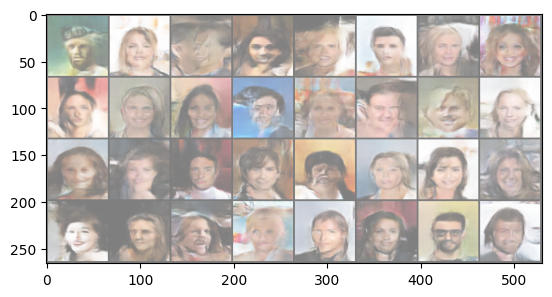

In [14]:
gen.train()
disc.train()

for epoch in range(NUM_EPOCHS):
    for batch_idx, (real, _ ) in enumerate(dataloader):
        real = real.to(device)
        ### create noise tensor
        noise = torch.randn((BATCH_SIZE, Z_DIM, 1, 1)).to(device)
        fake = gen(noise)

        ### Train Discriminator: max log(D(x)) + log(1 - D(G(z)))
        disc_real = disc(real).reshape(-1)
        loss_disc_real = criterion(disc_real, torch.ones_like(disc_real))
        disc_fake = disc(fake.detach()).reshape(-1)
        loss_disc_fake = criterion(disc_fake, torch.zeros_like(disc_fake))
        loss_disc = (loss_disc_real + loss_disc_fake) / 2
        disc.zero_grad()
        loss_disc.backward()
        opt_disc.step()

        ### Train Generator: min log(1 - D(G(z))) <-> max log(D(G(z))
        output = disc(fake).reshape(-1)
        loss_gen = criterion(output, torch.ones_like(output))
        gen.zero_grad()
        loss_gen.backward()
        opt_gen.step()

        ### Print losses occasionally and fake images occasionally
        if batch_idx % 50 == 0:
            print(
                f"Epoch [{epoch}/{NUM_EPOCHS}] Batch {batch_idx}/{len(dataloader)} \
                  Loss D: {loss_disc:.4f}, loss G: {loss_gen:.4f}"
            )
            with torch.no_grad():
                fake = gen(fixed_noise)
                img_grid_real = torchvision.utils.make_grid(real[:32], normalize=True)
                img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)
                show_tensor_images(img_grid_fake)

In [17]:
torch.save(disc.state_dict(), "disc.pth")
torch.save(gen.state_dict(), "gen.pth")



In [22]:
import torch
from torchvision.utils import save_image
import os

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define latent dimension (must match training!)
latent_dim = 100

gen.eval()

# Generate images
num_images = 5
z = torch.randn(num_images, latent_dim,1,1).to(device)
with torch.no_grad():
    fake_images = gen(z)

# Save output images
os.makedirs("generated_images", exist_ok=True)
save_image(fake_images, "generated_images/sample.png", nrow=num_images//2, normalize=True)

print("✅ Images saved to 'generated_images/sample.png'")


✅ Images saved to 'generated_images/sample.png'
